KELOMPOK 8:


*   Clarensia Novia Hartanoe (2602189436)
*   Shandez Darlene (2602189543)



In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings


In [ ]:
warnings.filterwarnings("ignore")

from google.colab import drive
drive.mount('/content/drive')

path_1 = '/content/drive/MyDrive/PROJECT RM/labeled_data.csv'
df = pd.read_csv(path_1)
df.head()

Mounted at /content/drive


,Unnamed: 0,count,hate_speech,offensive_language,neither,class,tweet
0,0,3,0,0,3,2,!!! RT @mayasolovely: As a woman you shouldn't...
1,1,3,0,3,0,1,!!!!! RT @mleew17: boy dats cold...tyga dwn ba...
2,2,3,0,3,0,1,!!!!!!! RT @UrKindOfBrand Dawg!!!! RT @80sbaby...
3,3,3,0,2,1,1,!!!!!!!!! RT @C_G_Anderson: @viva_based she lo...
4,4,6,0,6,0,1,!!!!!!!!!!!!! RT @ShenikaRoberts: The shit you...


#Data Augmentasi untuk memperbanyak label 2

In [ ]:
!pip install nlpaug

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.5/410.5 kB 24.6 MB/s eta 0:00:00


In [ ]:
import nlpaug.augmenter.word as naw

# Filter data kelas 2
df_class_2 = df[df['class'] == 2]

In [ ]:
# Augmenter menggunakan synonym augmentation
aug = naw.SynonymAug(aug_src='wordnet')

# Fungsi untuk melakukan augmentasi
def augment_data(df, augmenter, n_times=1):
    augmented_tweets = []
    for _ in range(n_times):
        for tweet in df['tweet']:
            augmented_tweet = augmenter.augment(tweet)
            augmented_tweets.append({
                'count': df['count'].values[0],
                'hate_speech': df['hate_speech'].values[0],
                'offensive_language': df['offensive_language'].values[0],
                'neither': df['neither'].values[0],
                'class': df['class'].values[0],
                'tweet': augmented_tweet
            })
    return pd.DataFrame(augmented_tweets)

# Augment data kelas 2 sebanyak 10 kali (misalnya)
df_augmented_more = augment_data(df_class_2, aug, n_times=5)


[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


In [ ]:
# Menggabungkan data asli dengan data augmentasi
df_combined = pd.concat([df, df_augmented_more], ignore_index=True)

# Menyimpan dataset yang sudah di-augmentasi
df_combined.to_csv('augmented_dataset.csv', index=False)


In [ ]:
df = pd.read_csv('augmented_dataset.csv')
df.head()

,Unnamed: 0,count,hate_speech,offensive_language,neither,class,tweet
0,0.0,3,0,0,3,2,!!! RT @mayasolovely: As a woman you shouldn't...
1,1.0,3,0,3,0,1,!!!!! RT @mleew17: boy dats cold...tyga dwn ba...
2,2.0,3,0,3,0,1,!!!!!!! RT @UrKindOfBrand Dawg!!!! RT @80sbaby...
3,3.0,3,0,2,1,1,!!!!!!!!! RT @C_G_Anderson: @viva_based she lo...
4,4.0,6,0,6,0,1,!!!!!!!!!!!!! RT @ShenikaRoberts: The shit you...


In [ ]:
print("Jumlah baris dan kolom:", df.shape)

Jumlah baris dan kolom: (45598, 7)


# Data Cleaning

1. Mencari missing value

In [ ]:
df.isna().sum()

,0
Unnamed: 0,20815
count,0
hate_speech,0
offensive_language,0
neither,0
class,0
tweet,0


Hasil: tidak ada missing value

2. Mengubah semua tweet menjadi lowercase

In [ ]:
df['tweet'] = df['tweet'].apply(lambda x:x.lower())

In [ ]:
df['tweet']

,tweet
0,!!! rt @mayasolovely: as a woman you shouldn't complain about cleaning up your house. &amp; as a man you should always take the trash out...
1,!!!!! rt @mleew17: boy dats cold...tyga dwn bad for cuffin dat hoe in the 1st place!!
2,!!!!!!! rt @urkindofbrand dawg!!!! rt @80sbaby4life: you ever fuck a bitch and she start to cry? you be confused as shit
3,!!!!!!!!! rt @c_g_anderson: @viva_based she look like a tranny
4,!!!!!!!!!!!!! rt @shenikaroberts: the shit you hear about me might be true or it might be faker than the bitch who told it to ya &#57361;
5,"!!!!!!!!!!!!!!!!!!""@t_madison_x: the shit just blows me..claim you so faithful and down for somebody but still fucking with hoes! &#128514;&#128514;&#128514;"""
6,"!!!!!!""@__brighterdays: i can not just sit up and hate on another bitch .. i got too much shit going on!"""
7,!!!!&#8220;@selfiequeenbri: cause i'm tired of you big bitches coming for us skinny girls!!&#8221;
8,""" &amp; you might not get ya bitch back &amp; thats that """
9,""" @rhythmixx_ :hobbies include: fighting mariam""\n\nbitch"


3. Menghapus karakter/simbol yang tidak diperlukan

In [ ]:
import re
import string

def clean(text):
    text = re.sub('https?://\S+|www\.\S+', '', text)
    text = re.sub('<.*?>+', '', text)
    text = re.sub('rt', '', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('\n', '', text)
    text = re.sub('\w*\d\w*', '', text)
    return text

df['tweet'] = df['tweet'].apply(clean)
df['tweet']

,tweet
0,mayasolovely as a woman you shouldnt complain about cleaning up your house amp as a man you should always take the trash out
1,boy dats coldtyga dwn bad for cuffin dat hoe in the place
2,urkindofbrand dawg you ever fuck a bitch and she sta to cry you be confused as shit
3,cganderson vivabased she look like a tranny
4,shenikarobes the shit you hear about me might be true or it might be faker than the bitch who told it to ya
5,tmadisonx the shit just blows meclaim you so faithful and down for somebody but still fucking with hoes
6,brighterdays i can not just sit up and hate on another bitch i got too much shit going on
7,cause im tired of you big bitches coming for us skinny
8,amp you might not get ya bitch back amp thats that
9,rhythmixx hobbies include fighting mariambitch


4. Text prepocessing - penghapusan stop word

In [ ]:
import nltk
from nltk.corpus import stopwords
nltk.download("stopwords")
nltk.download('punkt')
from nltk.tokenize import word_tokenize

sw = set(stopwords.words("english"))

def remove_stopwords(text):
    tokens = word_tokenize(text)
    cleaned_tokens = [word for word in tokens if word.lower() not in sw]
    return " ".join(cleaned_tokens)


df['tweet'] = df['tweet'].apply(remove_stopwords)
df['tweet'].head(10)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


,tweet
0,mayasolovely woman shouldnt complain cleaning house amp man always take trash
1,boy dats coldtyga dwn bad cuffin dat hoe place
2,urkindofbrand dawg ever fuck bitch sta cry confused shit
3,cganderson vivabased look like tranny
4,shenikarobes shit hear might true might faker bitch told ya
5,tmadisonx shit blows meclaim faithful somebody still fucking hoes
6,brighterdays sit hate another bitch got much shit going
7,cause im tired big bitches coming us skinny
8,amp might get ya bitch back amp thats
9,rhythmixx hobbies include fighting mariambitch


#Data Visualization

Bar Plot

<Axes: xlabel='category', ylabel='count'>

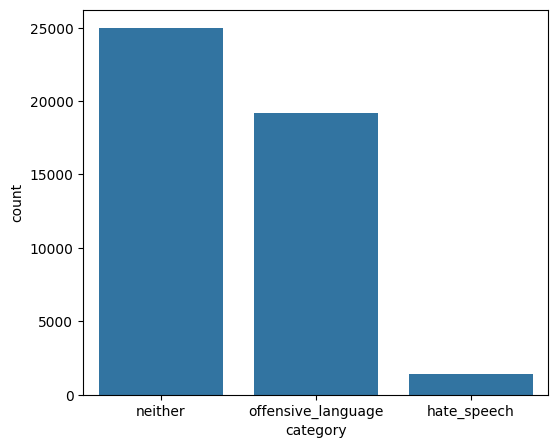

In [ ]:
#changes 0 -> hate speech, 1 -> offensive, 2 -> neither (search for imbalance)
df['category'] = df['class'].map({0:'hate_speech', 1:'offensive_language', 2:'neither'})

fig, axs = plt.subplots(figsize=(6,5))
sns.countplot(x='category',data=df,ax=axs)


comment yang tergolong dalam offensive language memiliki jumlah yang paling banyak dan cenderung jauh dengan kategori lainnya

WordCloud

In [ ]:
text_wordcloud = " ".join(i for i in df['tweet'])

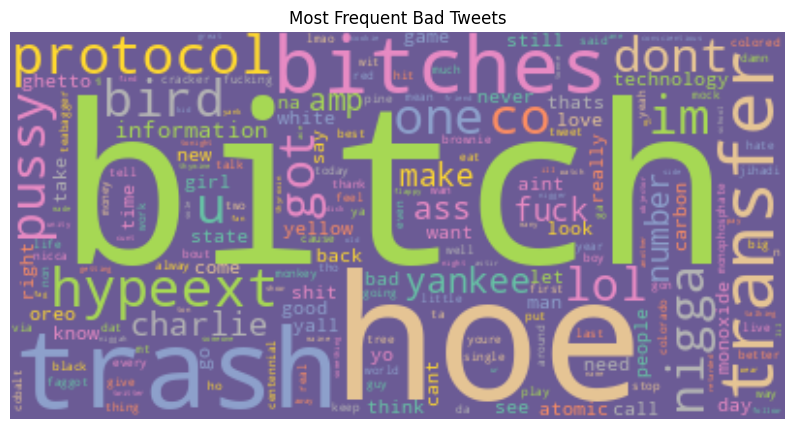

In [ ]:
from wordcloud import WordCloud


wordcloud = WordCloud(
    background_color="#6B5B95",
    colormap="Set2",
    collocations=False).generate(text_wordcloud)

plt.figure(figsize=(10,6))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title("Most Frequent Bad Tweets")
plt.show()

#Class Aggregation

menggabungkan label 0 (hate speech) dan 1 (offensive language)

In [ ]:
print(df['class'].value_counts())

class
2    24978
1    19190
0     1430
Name: count, dtype: int64


In [ ]:
df['class'] = df['class'].replace({0: 1})
print(df['class'].value_counts())

class
2    24978
1    20620
Name: count, dtype: int64


#Data Selection

drop semua kolom kecuali kolom 'class' dan 'tweet'

In [ ]:
df.drop(['Unnamed: 0','count', 'hate_speech', 'offensive_language', 'neither', 'category'],axis=1,inplace=True)

In [ ]:
df.head(10)

,class,tweet
0,2,mayasolovely woman shouldnt complain cleaning ...
1,1,boy dats coldtyga dwn bad cuffin dat hoe place
2,1,urkindofbrand dawg ever fuck bitch sta cry con...
3,1,cganderson vivabased look like tranny
4,1,shenikarobes shit hear might true might faker ...
5,1,tmadisonx shit blows meclaim faithful somebody...
6,1,brighterdays sit hate another bitch got much s...
7,1,cause im tired big bitches coming us skinny
8,1,amp might get ya bitch back amp thats
9,1,rhythmixx hobbies include fighting mariambitch


#Split Data

In [ ]:
from sklearn.model_selection import train_test_split

x = df['tweet']
y = df['class']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

#Word Embedding

Fast Text

In [ ]:
!pip install fasttext

import fasttext
import fasttext.util
from nltk.tokenize import word_tokenize

# Download pre-trained fastText model (if not already downloaded)
fasttext.util.download_model('en', if_exists='ignore')

# Load the pre-trained model
ft_model = fasttext.load_model('cc.en.300.bin')
# Fungsi untuk mengonversi teks menjadi vektor menggunakan FastText
def text_to_vector(text, model):
    tokens = text.split()  # Anda bisa mengabaikan tokenisasi jika sudah dilakukan sebelumnya
    word_vectors = [model.get_word_vector(word) for word in tokens if word in model]
    if len(word_vectors) == 0:
        return np.zeros(300)
    return np.mean(word_vectors, axis=0)

# Konversi teks training dan testing ke vektor
x_train_fasttext = np.array([text_to_vector(text, ft_model) for text in x_train])
x_test_fasttext = np.array([text_to_vector(text, ft_model) for text in x_test])

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.4/73.4 kB 5.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached pybind11-2.13.1-py3-none-any.whl.metadata (9.5 kB)
Using cached pybind11-2.13.1-py3-none-any.whl (238 kB)
  Created wheel for fasttext: filename=fasttext-0.9.3-cp310-cp310-linux_x86_64.whl size=4246765 sha256=1a25ea16e0843a47ac88d8548ecb4d380a1db35017468eb66ed723449f3bb1f6
  Stored in directory: /root/.cache/pip/wheels/0d/a2/00/81db54d3e6a8199b829d58e02cec2ddb20ce3e59fad8d3c92a
Successfully built fasttext



#Pemodelan

In [ ]:
from sklearn.metrics import classification_report, accuracy_score

SVM

In [ ]:
# Melatih model SVM
from sklearn.svm import SVC
svm_model = SVC(kernel='linear')
svm_model.fit(x_train_fasttext, y_train)

# Evaluasi model
y_pred = svm_model.predict(x_test_fasttext)
print("Accuracy: ", accuracy_score(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))

Accuracy:  0.9442982456140351
Classification Report:
               precision    recall  f1-score   support

           1       0.96      0.92      0.94      4163
           2       0.94      0.96      0.95      4957

    accuracy                           0.94      9120
   macro avg       0.95      0.94      0.94      9120
weighted avg       0.94      0.94      0.94      9120



RNN

In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Embedding, Dense, SpatialDropout1D, Bidirectional, Flatten
from tensorflow.keras.utils import to_categorical

In [ ]:
# Menggunakan tokenizer untuk mempersiapkan data
tokenizer = Tokenizer()
tokenizer.fit_on_texts(x_train)
word_index = tokenizer.word_index

embedding_dim = 300
embedding_matrix = np.zeros((len(word_index) + 1, embedding_dim))

In [ ]:
for word, i in word_index.items():
    try:
        embedding_vector = ft_model.get_word_vector(word)
        embedding_matrix[i] = embedding_vector
    except KeyError:
        embedding_matrix[i] = np.zeros(embedding_dim)

# Convert texts to sequences
X_train_seq = tokenizer.texts_to_sequences(x_train)
X_test_seq = tokenizer.texts_to_sequences(x_test)

In [ ]:
# Pad sequences
max_length = 25  # Anda bisa menyesuaikan panjang ini sesuai kebutuhan
X_train_pad = pad_sequences(X_train_seq, maxlen=max_length)
X_test_pad = pad_sequences(X_test_seq, maxlen=max_length)

# Convert labels to categorical
y_train_cat = to_categorical(y_train)
y_test_cat = to_categorical(y_test)

In [ ]:
# Define the model
RNN = Sequential()
RNN.add(Embedding(len(word_index) + 1, embedding_dim, weights=[embedding_matrix], input_length=max_length, trainable=False))
RNN.add(Flatten())
RNN.add(Dense(128, activation='relu'))
RNN.add(Dense(3, activation='sigmoid'))
RNN.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
batch_size = 64
history = RNN.fit(X_train_pad, y_train_cat, batch_size=batch_size, epochs=10, validation_split=0.1)

Epoch 1/10
513/513 ━━━━━━━━━━━━━━━━━━━━ 11s 19ms/step - accuracy: 0.8862 - loss: 0.3151 - val_accuracy: 0.9400 - val_loss: 0.1664
Epoch 2/10
513/513 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - accuracy: 0.9514 - loss: 0.1348 - val_accuracy: 0.9435 - val_loss: 0.1504
Epoch 3/10
513/513 ━━━━━━━━━━━━━━━━━━━━ 10s 14ms/step - accuracy: 0.9623 - loss: 0.1045 - val_accuracy: 0.9498 - val_loss: 0.1452
Epoch 4/10
513/513 ━━━━━━━━━━━━━━━━━━━━ 10s 18ms/step - accuracy: 0.9732 - loss: 0.0767 - val_accuracy: 0.9564 - val_loss: 0.1374
Epoch 5/10
513/513 ━━━━━━━━━━━━━━━━━━━━ 10s 18ms/step - accuracy: 0.9836 - loss: 0.0523 - val_accuracy: 0.9537 - val_loss: 0.1528
Epoch 6/10
513/513 ━━━━━━━━━━━━━━━━━━━━ 11s 19ms/step - accuracy: 0.9891 - loss: 0.0374 - val_accuracy: 0.9482 - val_loss: 0.1819
Epoch 7/10
513/513 ━━━━━━━━━━━━━━━━━━━━ 10s 19ms/step - accuracy: 0.9931 - loss: 0.0271 - val_accuracy: 0.9534 - val_loss: 0.1815
Epoch 8/10
513/513 ━━━━━━━━━━━━━━━━━━━━ 7s 14ms/step - accuracy: 0.9945 - loss: 0.0221 - va

In [ ]:
# Evaluate the model
results = RNN.evaluate(X_test_pad, y_test_cat)
pred = RNN.predict(X_test_pad)
print(results)
print("Max Accuracy: ", max(history.history['accuracy']))
print("Max validation accuracy: ", max(history.history['val_accuracy']))

# Convert predictions to class labels
y_pred = np.argmax(pred, axis=1)
y_true = np.argmax(y_test_cat, axis=1)

# Print classification report
print(classification_report(y_true, y_pred))

285/285 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.9510 - loss: 0.2143
285/285 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
[0.21478450298309326, 0.9512061476707458]
Max Accuracy:  0.9974413514137268
Max validation accuracy:  0.9580591917037964
              precision    recall  f1-score   support

           1       0.96      0.93      0.95      4163
           2       0.94      0.97      0.96      4957

    accuracy                           0.95      9120
   macro avg       0.95      0.95      0.95      9120
weighted avg       0.95      0.95      0.95      9120



In [ ]:
results = RNN.evaluate(X_test_pad, y_test_cat)
test_accuracy = results[1]  # Akurasi adalah metrik kedua setelah loss
print("Test Accuracy: ", test_accuracy)

285/285 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9510 - loss: 0.2143
Test Accuracy:  0.9512061476707458


Random Forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier()

In [ ]:
rf.fit(x_train_fasttext, y_train)

RandomForestClassifier()

In [ ]:
y_pred1 = rf.predict(x_test_fasttext)
print(classification_report(y_test, y_pred1))
print("Accuracy: ", accuracy_score(y_test, y_pred1))

              precision    recall  f1-score   support

           1       0.94      0.90      0.92      4163
           2       0.92      0.95      0.93      4957

    accuracy                           0.93      9120
   macro avg       0.93      0.93      0.93      9120
weighted avg       0.93      0.93      0.93      9120

Accuracy:  0.9273026315789473


LSTM

In [ ]:
# prompt: how to combine LSTM model with FastText Embedding

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dense

# Assuming x_resampledOver and y_resampledOver are your balanced data
# and x_test_fasttext is your test data with FastText embeddings

# Define the LSTM model
model = Sequential()
model.add(LSTM(128, input_shape=(x_train_fasttext.shape[1], 1)))  # Reshape for LSTM
model.add(Dense(3, activation='softmax'))  # 3 output classes

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Reshape data for LSTM input (samples, timesteps, features)
x_train_fasttext_reshaped = x_train_fasttext.reshape(x_train_fasttext.shape[0], x_train_fasttext.shape[1], 1)
x_test_fasttext_reshaped = x_test_fasttext.reshape(x_test_fasttext.shape[0], x_test_fasttext.shape[1], 1)

# Train the model
model.fit(x_train_fasttext_reshaped, y_train, epochs=10, batch_size=32)

# Evaluate the model
y_pred_probs = model.predict(x_test_fasttext_reshaped)
y_pred = np.argmax(y_pred_probs, axis=1)

print(classification_report(y_test, y_pred))
print("Accuracy: ", accuracy_score(y_test, y_pred))

Epoch 1/10
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 380s 332ms/step - accuracy: 0.5559 - loss: 0.7016
Epoch 2/10
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 393s 341ms/step - accuracy: 0.6221 - loss: 0.6631
Epoch 3/10
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 437s 337ms/step - accuracy: 0.6565 - loss: 0.6314
Epoch 4/10
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 504s 391ms/step - accuracy: 0.6522 - loss: 0.6351
Epoch 5/10
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 430s 328ms/step - accuracy: 0.6677 - loss: 0.6227
Epoch 6/10
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 392s 337ms/step - accuracy: 0.6863 - loss: 0.6030
Epoch 7/10
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 438s 334ms/step - accuracy: 0.7697 - loss: 0.5001
Epoch 8/10
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 377s 329ms/step - accuracy: 0.8076 - loss: 0.4362
Epoch 9/10
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 383s 331ms/step - accuracy: 0.8143 - loss: 0.4225
Epoch 10/10
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 377s 330ms/step - accuracy: 0.8172 - loss: 0.4204
285/285 ━━━━━━━━━━━━━━━━━━━━ 38s 131ms/step
              precision    recall  